In [ ]:
# system imports
from pathlib import Path
from typing import Dict, List, Union, Tuple, Any, Optional
import click
import warnings
from multiprocessing import Pool, cpu_count
from tqdm import tqdm
from collections import defaultdict

# only show warnings once
warnings.filterwarnings("ignore")

# plotting imports
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
import plotly.figure_factory as ff
import matplotlib.pyplot as plt
import seaborn as sns
from plotly.subplots import make_subplots

# feature extraction and machine learning imports
import scipy
import numpy as np
import pandas as pd
import tsfel
from tsfresh import extract_features, select_features
import pycatch22
from imblearn.pipeline import Pipeline, make_pipeline
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler
from sklearn.decomposition import PCA
from imblearn.over_sampling import SMOTE
from sklearn.feature_selection import (
    VarianceThreshold,
    SelectKBest,
    SelectPercentile,
    f_classif,
    mutual_info_classif,
    SelectFromModel,
)
from sklearn.model_selection import train_test_split, StratifiedGroupKFold
from sklearn.metrics import (
    accuracy_score,
    balanced_accuracy_score,
    precision_score,
    recall_score,
    f1_score,
    roc_auc_score,
    confusion_matrix,
    ConfusionMatrixDisplay,
    classification_report,
    matthews_corrcoef,
    roc_curve,
    auc,
    make_scorer,
    precision_recall_curve,
)
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, cross_validate
from sklearn.ensemble import RandomForestClassifier
from sklearn import set_config


# custom imports
from egfet.load_data import load_egfet_dataset, get_metadata_labels_groups

In [1]:
data = load_egfet_dataset("/data/aros/Histones/PavlidisGroup/EGFET Data/", verbose=3)
data.head(n=20)

NameError: name 'load_egfet_dataset' is not defined

In [ ]:
# get the average threshold voltage for each device

def get_delvth(ids:np.ndarray, vds:np.ndarray, vgs:np.ndarray, gm:float, base_vth:float) -> pd.DataFrame:
    """Get the change in threshold voltage for each device
    
    ids = mu * Cox * W/L * (Vref - Vth)Vds - 1/2 Vds^2

    Vth = Vref - 1/Vds  (((ids * L) / (mu  * Co * W) + 1/2 Vds^2)

    Args:
        ids (np.ndarray): drain current
        vds (np.ndarray): drain-source voltage
        vgs (np.ndarray): gate-source voltage
        gm (float): transconductance

    Returns:
        (np.ndarray): threshold voltage
    
    """
    coeff = gm / vds
    vth =  vgs-  1/vds * (ids / coeff + 1/2 * vds**2) 
    delvth = vth - base_vth
    return delvth



In [ ]:
# list experiments
# indices are Experiment, Concentration, Trial, Cycle, index
# get all unique experiments
experiments = data.index.get_level_values(0).unique()
print(experiments)

Index(['20240318_Histones_BSA_1', '20230929_1_BSA_Hapt_2kPEG',
       '0240318_Histones_BSA_2', '20240318_Histones_BSA_Test_set',
       '20221214_HP_HBS_CTH', '20230929_2_BSA_Hapt_2kPEG',
       '20230525_Hapt_2kPeg_H4', '20230518_H4_Rod', '0240318_Histones_BSA_3',
       '20230526_Hapt_24_H4', '20230518_CTH_2kPEG',
       '20230519_H2kPEG_H4_NoPolish', '20240108_CTH_Hapt_2kPEG_24hr',
       '20230518_H4_2kPEG'],
      dtype='object', name='Experiment')


In [ ]:
# experiments under the same conditions
PEG2K_Hapt = [
    "20230525_Hapt_2kPeg_H4",
    "20230526_Hapt_24_H4",
    "20230518_H4_2kPEG"
]
# transconductance of the transistor
gm = 225 / 1000 # S
base_vth = 0.75 # V

def get_experiment_data(data:pd.DataFrame, experiment:str, gm:float, base_vth:float) -> pd.DataFrame:
    """Get the data for a specific experiment
    
    Args:
        data (pd.DataFrame): data
        experiment (str): experiment name
        gm (float): transconductance
        base_vth (float): base threshold voltage
        
    Returns:
        pd.DataFrame: experiment data
    """
    # get the data for the experiment
    exp_data = data.loc[experiment]
    # get the threshold voltage
    exp_data["delvth (V)"] = get_delvth(exp_data["Drain Current (nA)"] / 1e9 , exp_data["Drain Voltage (V)"], exp_data["Gate Voltage (V)"], gm, base_vth)
    return exp_data



In [ ]:
h4_data = get_experiment_data(data, PEG2K_Hapt, gm, base_vth)
h4_data.head(n=20)

level_0  \
Experiment             Concentration Trial Cycle index            
20230525_Hapt_2kPeg_H4 100.0         1     0     0            0   
                                                 1            1   
                                                 2            2   
                                                 3            3   
                                                 4            4   
                                                 5            5   
                                                 6            6   
                                                 7            7   
                                                 8            8   
                                                 9            9   
                                                 10          10   
                                                 11          11   
                                                 12          12   
                                                 13          13   
                                                 14          14   
                                                 15          15   
                                                 16          16   
                                                 17          17   
                                                 18          18   
                                                 19          19   

                                                        Drain Voltage (V)  \
Experiment             Concentration Trial Cycle index                      
20230525_Hapt_2kPeg_H4 100.0         1     0     0               0.500004   
                                                 1               0.499992   
                                                 2               0.499989   
                                                 3               0.499986   
                                                 4               0.499983   
                                                 5               0.499978   
                                                 6               0.500000   
                                                 7               0.499999   
                                                 8               0.499999   
                                                 9               0.499999   
                                                 10              0.499999   
                                                 11              0.499998   
                                                 12              0.499998   
                                                 13              0.499997   
                                                 14              0.499996   
                                                 15              0.500000   
                                                 16              0.499999   
                                                 17              0.499999   
                                                 18              0.499999   
                                                 19              0.499999   

                                                        Drain Current (nA)  \
Experiment             Concentration Trial Cycle index                       
20230525_Hapt_2kPeg_H4 100.0         1     0     0                 31.1377   
                                                 1                 39.1753   
                                                 2                 49.3052   
                                                 3                 62.1135   
                                                 4                 78.3178   
                                                 5                 98.8171   
                                                 6                124.7690   
                                                 7                157.6870   
                                                 8                199.4550   
                            

In [ ]:
test_data = h4_data.reset_index()
test_data["Drain Current (nA)"] = np.log(test_data["Drain Current (nA)"])
# log of the concentration
test_data["Concentration"] = np.log(test_data["Concentration"])
fig = px.scatter(test_data, x="Gate Voltage (V)", y="Drain Current (nA)", color="Concentration", title="H4 2kPEG")
# set color bar to viridis
fig.show()

In [ ]:
# average delvth by concentration
avg_vth = h4_data.groupby(["Concentration"])["delvth (V)"].mean()

avg_vth.head()

Concentration
0.01     -0.619750
0.10     -0.619112
1.00     -0.618989
10.00    -0.618811
100.00   -0.617357
Name: delvth (V), dtype: float64

In [ ]:
fig = go.Figure()
# get all unique Gate Voltage values
gate_voltages = h4_data["Gate Voltage (V)"].unique()[:10:]
for gate_voltage in gate_voltages:
    gate_data = h4_data[h4_data["Gate Voltage (V)"] == gate_voltage]
    # group by concentration
    errors = gate_data.groupby(["Concentration"])["delvth (V)"].std().reset_index()
    gate_data = gate_data.groupby(["Concentration"])["delvth (V)"].mean().reset_index()
    fig.add_trace(go.Scatter(x=gate_data["Concentration"], y=gate_data["delvth (V)"], name=f"Gate Voltage: {gate_voltage}", mode="lines+markers"))
    # add error bars
    fig.add_trace(go.Scatter(x=errors["Concentration"], y=gate_data["delvth (V)"] + 2*errors["delvth (V)"], mode="lines", showlegend=False, line=dict(width=0.5, color="black")))
    fig.add_trace(go.Scatter(x=errors["Concentration"], y=gate_data["delvth (V)"] - 2*errors["delvth (V)"], mode="lines", showlegend=False, fill="tonexty", line=dict(width=0.5, color="black")))
fig.update_layout(title=f"Delta V_t at {gate_voltage}", xaxis_title="Concentration", yaxis_title="Average delvth (V)")
fig.show()


In [ ]:
fig = go.Figure()
# get all unique Gate Voltage values
gate_voltages = h4_data["Gate Voltage (V)"].unique()[::100]
for gate_voltage in gate_voltages:
    gate_data = h4_data[h4_data["Gate Voltage (V)"] == gate_voltage]
    # print all concentrations
    print(gate_data.reset_index()["Concentration"].unique())
    errors = gate_data.groupby(["Concentration"])["Drain Current (nA)"].std().reset_index()
    gate_data = gate_data.groupby(["Concentration"])["Drain Current (nA)"].mean().reset_index()
    
    fig.add_trace(go.Scatter(x=gate_data["Concentration"], y=gate_data["Drain Current (nA)"], name=f"Gate Voltage: {gate_voltage}", mode="lines+markers"))
    # add error bars
    fig.add_trace(go.Scatter(x=errors["Concentration"], y=gate_data["Drain Current (nA)"] + errors["Drain Current (nA)"], mode="lines", showlegend=False, line=dict(width=0.5, color="black")))
    fig.add_trace(go.Scatter(x=errors["Concentration"], y=gate_data["Drain Current (nA)"] - errors["Drain Current (nA)"], mode="lines", showlegend=False, fill="tonexty", line=dict(width=0.5, color="black")))
fig.update_layout(title=f"Delta V_t at {gate_voltage}", xaxis_title="Concentration", yaxis_title="Average Drain Current (V)", xaxis_type="log")
fig.show()

[1.e+02 1.e+01 1.e+00 1.e-01 1.e-02]
[1.e+02 1.e+01 1.e+00 1.e-01 1.e-02]
[1.e+02 1.e+01 1.e+00 1.e-01 1.e-02]
[1.e+02 1.e+01 1.e+00 1.e-01 1.e-02]
[1.e+02 1.e+01 1.e+00 1.e-01 1.e-02]
[1.e+02 1.e+01 1.e+00 1.e-01 1.e-02]
[1.e+02 1.e+01 1.e+00 1.e-01 1.e-02]
[1.e+02 1.e+01 1.e+00 1.e-01 1.e-02]
[100.]
[100.    1.    0.1  10. ]
[100.]


In [ ]:
# import decomposition methods from sklearn
from sklearn.decomposition import PCA
from sklearn.decomposition import FastICA
from sklearn.decomposition import FactorAnalysis
from sklearn.decomposition import KernelPCA
from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import DictionaryLearning

# import manifold methods from sklearn
from sklearn.manifold import MDS
from sklearn.manifold import TSNE
from sklearn.manifold import Isomap
from sklearn.manifold import LocallyLinearEmbedding



In [ ]:
organized_data = []
analyte_type = []
concentration = []
lengths = []
# get indices
indices = data.index
#drop last index
indices = indices.droplevel(-1).unique()
min_length = 100000
for index in indices:
    idx = index 
    index_data = data.loc[idx]
    if len(index_data) < 60:
        continue
    lengths.append(len(index_data))
    min_length = min(min_length, len(index_data))
    concentration.append(idx[1])
    # get the data for the index
    
    # get the PCA decomposition
    organized_data.append(index_data.values[:60])
    if "Hapt" in index[0]:
        analyte_type.append("Hapt")
    if "BSA" in index[0]:
        analyte_type.append("BSA")
    if "CTH" in index[0]:
        analyte_type.append("CTH")
# concatenate the data
print(min_length)


60


(array([5749.,  565.,  270.,  128.,  168.,   79.,   30.,   37.,    6.,
          18.]),
 array([60. , 63.1, 66.2, 69.3, 72.4, 75.5, 78.6, 81.7, 84.8, 87.9, 91. ]),
 <BarContainer object of 10 artists>)

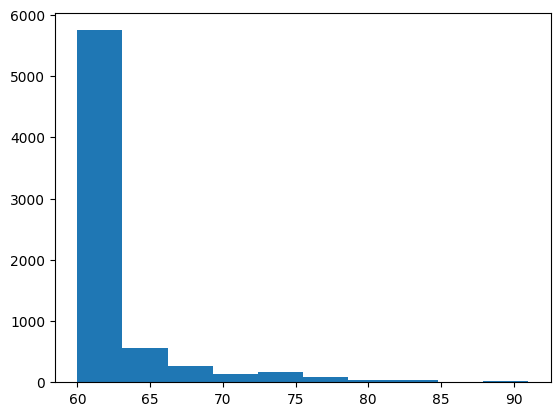

In [ ]:
# histogram of lengths
plt.hist(lengths)

In [ ]:
print(len(analyte_type))

7207


In [ ]:
organized_data = np.asarray(organized_data)
analyte_type = np.asarray(analyte_type)
concentration = np.asarray(concentration)
# downsample the data
organized_data = organized_data[::10,:]
analyte_type = analyte_type[::10]
concentration = concentration[::10]

pca = PCA(n_components=2)
pca_data = np.asarray(pca.fit_transform(organized_data.reshape(organized_data.shape[0], -1)))

In [ ]:
# Plot the PCA data
import plotly.graph_objects as go
import plotly.express as px

color_map = {
    "Hapt": "red",
    "BSA": "blue",
    "CTH": "green"
}

colors = [color_map[atype] for atype in analyte_type]

fig = go.Figure()
fig.add_trace(go.Scatter(x=pca_data[:, 0], y=pca_data[:, 1], mode="markers", marker=dict(color=colors), text=concentration))
fig.show()

In [ ]:
# 3d pca
pca = PCA(n_components=3)
pca_data = np.asarray(pca.fit_transform(organized_data.reshape(organized_data.shape[0], -1)))

fig = go.Figure()
fig.add_trace(go.Scatter3d(x=pca_data[:, 0], y=pca_data[:, 1], z=pca_data[:, 2], mode="markers", marker=dict(color=colors), text=concentration))
fig.show()

In [ ]:
# extract tsfel, tsfresh, and catch22 features
from embc2024 import prepare_egfet_data

In [ ]:
# extract all features
features = prepare_egfet_data("/data/aros/Histones/PavlidisGroup/EGFET Data/")

Concentration: 1 nM
Concentration: 0 pM
Concentration: 10 nM
Concentration: 0 pM
Concentration: 0 pM
Unable to find concentration in filename: 20240318_Histones_BSA_HBS_All.xlsx
Concentration: 100 nM
Concentration: 100 pM
Concentration: 0 pM
Concentration: 0 pM
Concentration: 100 pM
Concentration: 0 pM
Concentration: 100 nM
Concentration: 0 pM
Concentration: 10 pM
Concentration: 10 pM
Concentration: 1 nM
Concentration: 10 nM
Concentration: 0 pM
Concentration: 100 pM
Concentration: 0 pM
Concentration: 0 pM
Concentration: 100 nM
Concentration: 1 nM
Concentration: 10 pM
Concentration: 10 pM
Concentration: 100 pM
Concentration: 10 nM
Concentration: 0 pM
Concentration: 0 pM
Concentration: 0 pM
Concentration: 10 nM
Concentration: 1 nM
Concentration: 100 nM
Concentration: 10 pM
Concentration: 1 nM
Concentration: 100 nM
Concentration: 0 pM
Concentration: 10 nM
Concentration: 100 nM
Concentration: 0 pM
Concentration: 1 nM
Concentration: 0 pM
Concentration: 100 pM
Concentration: 100 pM
Concentra

/projects/aros/histones/Histones/modeling/histones_modeling/src/histones_modeling/embc2024.py:205: PerformanceWarning:

indexing past lexsort depth may impact performance.



Number of curves: 7050


Feature Extraction: 100%|██████████| 80/80 [00:19<00:00,  4.10it/s]


Removed 553 collinear features


In [ ]:
pca = PCA(n_components=2)
pca_data = pca.fit_transform(features).to_numpy()
print(pca_data.shape)
analyte_types = []
for atype in features.index.get_level_values(0):
    if "Hapt" in atype or "H4" in atype:
        analyte_types.append("Hapt")
    elif "BSA" in atype:
        analyte_types.append("BSA")
    elif "CTH" in atype:
        analyte_types.append("CTH")
    else:
        print(f"{atype} is not mapped")

color_map = {
    "Hapt": "red",
    "BSA": "blue",
    "CTH": "green"
}
colors = [color_map[atype] for atype in analyte_types]
analyte_types = np.asarray(analyte_types)
print(analyte_types.shape)
hapt_data = pca_data[analyte_types == "Hapt",:]
bsa_data = pca_data[analyte_types == "BSA",:]
cth_data = pca_data[analyte_types == "CTH",:]
print(hapt_data.shape)

fig = go.Figure()
fig.add_trace(go.Scatter(x=hapt_data[:, 0], y=hapt_data[:, 1], mode="markers", marker=dict(color="red"), name="Hapt"))
fig.add_trace(go.Scatter(x=bsa_data[:, 0], y=bsa_data[:, 1], mode="markers", marker=dict(color="blue"), name="BSA"))
fig.add_trace(go.Scatter(x=cth_data[:, 0], y=cth_data[:, 1], mode="markers", marker=dict(color="green"), name="CTH"))
# show legend
fig.update_layout(showlegend=True)
fig.show()

(7050, 2)
(7050,)
(4437, 2)


In [ ]:
pca = PCA(n_components=3)
pca_data = pca.fit_transform(features).to_numpy()
print(pca_data.shape)
analyte_types = []
for atype in features.index.get_level_values(0):
    if "Hapt" in atype or "H4" in atype:
        analyte_types.append("Hapt")
    elif "BSA" in atype:
        analyte_types.append("BSA")
    elif "CTH" in atype:
        analyte_types.append("CTH")
    else:
        print(f"{atype} is not mapped")

color_map = {
    "Hapt": "red",
    "BSA": "blue",
    "CTH": "green"
}
colors = [color_map[atype] for atype in analyte_types]
analyte_types = np.asarray(analyte_types)
print(analyte_types.shape)
hapt_data = pca_data[analyte_types == "Hapt",:]
bsa_data = pca_data[analyte_types == "BSA",:]
cth_data = pca_data[analyte_types == "CTH",:]
print(hapt_data.shape)

fig = go.Figure()
fig.add_trace(go.Scatter3d(x=hapt_data[:, 0], y=hapt_data[:, 1], z=hapt_data[:, 2], mode="markers", marker=dict(color="red"), name="Hapt"))
fig.add_trace(go.Scatter3d(x=bsa_data[:, 0], y=bsa_data[:, 1], z=bsa_data[:, 2], mode="markers", marker=dict(color="blue"), name="BSA"))
fig.add_trace(go.Scatter3d(x=cth_data[:, 0], y=cth_data[:, 1], z=cth_data[:, 2], mode="markers", marker=dict(color="green"), name="CTH"))
# show legend
fig.update_layout(showlegend=True)
fig.show()

(7050, 3)
(7050,)
(4437, 3)


## PCA Loading Analysis

In [ ]:
data = load_egfet_dataset(
    "/data/aros/Histones/PavlidisGroup/EGFET Data/", 
    exclude_experiments=["20230519_H2kPEG_H4_NoPolish", "20240108_CTH_Hapt_2kPEG_24hr"],
    verbose=3, 
    flatten=False
)

Folders:
['20240318_Histones_BSA_1', '20230929_1_BSA_Hapt_2kPEG', '0240318_Histones_BSA_2', '20240318_Histones_BSA_Test_set', '20221214_HP_HBS_CTH', '20230929_2_BSA_Hapt_2kPEG', '20230525_Hapt_2kPeg_H4', '20230518_H4_Rod', '0240318_Histones_BSA_3', '20230526_Hapt_24_H4', '20230518_CTH_2kPEG', '20230518_H4_2kPEG']
Loading 20240318_E1_Hapt_BSAHBS_1nM_2.xlsx
Concentration: 1 nM
Loaded /data/aros/Histones/PavlidisGroup/EGFET Data/20240318_Histones_BSA_1/20240318_E1_Hapt_BSAHBS_1nM_2.xlsx
Number of cycles: 58
Loading 20240318_E1_Hapt_BSAHBS_0pM_2.xlsx
Concentration: 0 pM
Loaded /data/aros/Histones/PavlidisGroup/EGFET Data/20240318_Histones_BSA_1/20240318_E1_Hapt_BSAHBS_0pM_2.xlsx
Number of cycles: 9
Loading 20240318_E1_Hapt_BSAHBS_10nM_1.xlsx
Concentration: 10 nM
Loaded /data/aros/Histones/PavlidisGroup/EGFET Data/20240318_Histones_BSA_1/20240318_E1_Hapt_BSAHBS_10nM_1.xlsx
Number of cycles: 62
Loading 20240318_E1_Hapt_BSAHBS_0pM_8.xlsx
Concentration: 0 pM
Loaded /data/aros/Histones/Pavlidis

In [ ]:
# load flattened data
flattened = load_egfet_dataset(
    "/data/aros/Histones/PavlidisGroup/EGFET Data/", 
    exclude_experiments=["20230519_H2kPEG_H4_NoPolish", "20240108_CTH_Hapt_2kPEG_24hr"],
    verbose=3, 
    flatten=True
)
flattened.head()

Folders:
['20240318_Histones_BSA_1', '20230929_1_BSA_Hapt_2kPEG', '0240318_Histones_BSA_2', '20240318_Histones_BSA_Test_set', '20221214_HP_HBS_CTH', '20230929_2_BSA_Hapt_2kPEG', '20230525_Hapt_2kPeg_H4', '20230518_H4_Rod', '0240318_Histones_BSA_3', '20230526_Hapt_24_H4', '20230518_CTH_2kPEG', '20230518_H4_2kPEG']
Loading 20240318_E1_Hapt_BSAHBS_1nM_2.xlsx
Concentration: 1 nM
Loaded /data/aros/Histones/PavlidisGroup/EGFET Data/20240318_Histones_BSA_1/20240318_E1_Hapt_BSAHBS_1nM_2.xlsx
Number of cycles: 58
Loading 20240318_E1_Hapt_BSAHBS_0pM_2.xlsx
Concentration: 0 pM
Loaded /data/aros/Histones/PavlidisGroup/EGFET Data/20240318_Histones_BSA_1/20240318_E1_Hapt_BSAHBS_0pM_2.xlsx
Number of cycles: 9
Loading 20240318_E1_Hapt_BSAHBS_10nM_1.xlsx
Concentration: 10 nM
Loaded /data/aros/Histones/PavlidisGroup/EGFET Data/20240318_Histones_BSA_1/20240318_E1_Hapt_BSAHBS_10nM_1.xlsx
Number of cycles: 62
Loading 20240318_E1_Hapt_BSAHBS_0pM_8.xlsx
Concentration: 0 pM
Loaded /data/aros/Histones/Pavlidis

level_0  \
Experiment              Concentration Trial Cycle index            
20240318_Histones_BSA_1 1.0           1     0     0            0   
                                                  1            1   
                                                  2            2   
                                                  3            3   
                                                  4            4   

                                                         Drain Voltage (V)  \
Experiment              Concentration Trial Cycle index                      
20240318_Histones_BSA_1 1.0           1     0     0               0.500001   
                                                  1               0.499999   
                                                  2               0.499999   
                                                  3               0.499999   
                                                  4               0.499999   

                                                         Drain Current (nA)  \
Experiment              Concentration Trial Cycle index                       
20240318_Histones_BSA_1 1.0           1     0     0                0.000000   
                                                  1                0.000001   
                                                  2                0.000002   
                                                  3                0.000004   
                                                  4                0.000006   

                                                         Time Elapsed (s)  \
Experiment              Concentration Trial Cycle index                     
20240318_Histones_BSA_1 1.0           1     0     0                 0.940   
                                                  1                 1.969   
                                                  2                 3.000   
                                                  3                 4.026   
                                                  4                 5.053   

                                                         Gate Voltage (V)  
Experiment              Concentration Trial Cycle index                    
20240318_Histones_BSA_1 1.0           1     0     0             -0.199966  
                                                  1             -0.179969  
                                                  2             -0.159974  
                                                  3             -0.139974  
                                                  4             -0.119976

In [ ]:
def prepare_data(data, stratify_level=2):
    organized_data = []
    analyte_type = []
    concentration = []
    lengths = []
    stratifykey = 0
    stratify_map = dict()
    # get indices
    indices = data.index
    #drop last index
    indices = indices.droplevel(-1).unique()
    stratify_groups = []
    min_length = 100000
    for index in indices:
        idx = index 
        index_data = data.loc[idx]
    
        if len(index_data) < 60:
            continue
        stratify_name = "".join([str(i) for i in idx[:-stratify_level]])
        key = stratify_map.get(stratify_name, stratifykey := stratifykey + 1)
        stratify_map[stratify_name] = key
        stratify_groups.append(key)
        lengths.append(len(index_data))
        min_length = min(min_length, len(index_data))
        concentration.append(idx[1])
    # get the data for the index
    
    # get the PCA decomposition
        organized_data.append(index_data["Drain Current (nA)"].values[:60])
        if ("Hapt" in index[0] or "H4" in index[0]) and "CTH" not in index[0] and "BSA" not in index[0]:
            analyte_type.append(0)
        if "BSA" in index[0]:
            analyte_type.append(1)
        if "CTH" in index[0]:
            analyte_type.append(2)
    return np.asarray(organized_data), np.asarray(analyte_type), np.asarray(concentration), np.asarray(stratify_groups)

def num_unique_groups(stratify_groups):
    return len(np.unique(stratify_groups))

In [ ]:
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split, cross_val_score, cross_validate
from sklearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score, f1_score, make_scorer, balanced_accuracy_score, precision_score, recall_score
from sklearn.model_selection import GroupShuffleSplit, StratifiedGroupKFold
from sklearn.decomposition import PCA
from sklearn.preprocessing import RobustScaler, StandardScaler
from sklearn.base import BaseEstimator, ClassifierMixin
from rich.progress import track, Progress

import xgboost as xgb
import numpy as np

import torch
import torch.nn as nn
import torch.optim as optim

class RepeatedStratifiedGroupKFold:
    def __init__(self, n_splits=5, n_repeats=100, random_state=None, shuffle=True):
        self.n_splits = n_splits
        self.n_repeats = n_repeats
        self.random_state = random_state
        self.shuffle = shuffle

    def split(self, X, y=None, groups=None):
        for _ in range(self.n_repeats):
            skf = StratifiedGroupKFold(n_splits=self.n_splits, shuffle=self.shuffle)
            for train_idx, test_idx in skf.split(X, y, groups):
                yield train_idx, test_idx

    def get_n_splits(self, X, y, groups):
        return self.n_splits * self.n_repeats

class SimpleConvNet1(nn.Module):
    def __init__(self, hidden_size=32):
        super().__init__()
        self.conv1 = nn.Conv1d(1, 64, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv1d(32, 64, kernel_size=3, stride=1, padding=1)
        # self.conv3 = nn.Conv1d(32, 64, kernel_size=3, stride=1, padding=1)
        self.fc1 = nn.Linear(hidden_size, 128)
        self.fc2 = nn.Linear(128, 3)
        self.relu = nn.ReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.flatten = nn.Flatten()

    def forward(self, x):
        x = x[:, None, :]
        x = self.relu(self.conv1(x))
        l1 = self.maxpool(x)

        x = self.relu(self.conv2(l1))
        l2 = self.maxpool(x)

        # x = self.relu(self.conv3(l2))
        # l3 = self.maxpool(x)

        x = self.flatten(l2)
        x = self.relu(self.fc1(x))
        x = self.fc2(x)
        return x
    
class SimpleConvNet2(nn.Module):
    def __init__(self, hidden_size=32):
        super().__init__()
        self.conv1 = nn.Conv1d(1, 64, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv1d(32, 64, kernel_size=3, stride=1, padding=1)
        self.conv3 = nn.Conv1d(32, 64, kernel_size=3, stride=1, padding=1)
        # self.conv4 = nn.Conv1d(32, 64, kernel_size=3, stride=1, padding=1)
        # self.conv5 = nn.Conv1d(32, 64, kernel_size=3, stride=1, padding=1)
        self.fc1 = nn.Linear(hidden_size, 128)
        self.fc2 = nn.Linear(128, 3)
        self.relu = nn.ReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.flatten = nn.Flatten()

    def forward(self, x):
        x = x[:, None, :]
        l1 = self.relu(self.conv1(x))
        x = self.maxpool(l1)

        l2 = self.relu(self.conv2(x))
        x = self.maxpool(l2)

        l3 = self.relu(self.conv3(x))
        x = self.maxpool(l3)

        # l4 = self.relu(self.conv4(x))
        # x = self.maxpool(l4)

        # l5 = self.relu(self.conv5(x))
        # x = self.maxpool(l5)

        x = self.flatten(x)
        x = self.relu(self.fc1(x))
        x = self.fc2(x)
        return x

class PyTorchConvNetClassifier(BaseEstimator, ClassifierMixin):
    def __init__(self, epochs=10, batch_size=32, learning_rate=0.001, hidden_size=32, model="simple1"):
        self.epochs = epochs
        self.batch_size = batch_size
        self.learning_rate = learning_rate
        self.hidden_size = hidden_size
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.model = model
        if model == "simple1":
            self.model = SimpleConvNet1(hidden_size=hidden_size).to(self.device)
        elif model == "simple2":
            self.model = SimpleConvNet2(hidden_size=hidden_size).to(self.device)
        self.criterion = nn.CrossEntropyLoss()
        self.optimizer = optim.Adam(self.model.parameters(), lr=self.learning_rate)

    def fit(self, X, y):
        self.model.train()
        X_tensor = torch.tensor(np.asarray(X), dtype=torch.float32).to(self.device)
        y_tensor = torch.tensor(np.asarray(y), dtype=torch.long).to(self.device)
        dataset = torch.utils.data.TensorDataset(X_tensor, y_tensor)
        dataloader = torch.utils.data.DataLoader(dataset, batch_size=self.batch_size, shuffle=True)

        for epoch in  track(range(self.epochs), description="Training model"):
            for batch_X, batch_y in dataloader:
                self.optimizer.zero_grad()
                outputs = self.model(batch_X)
                loss = self.criterion(outputs, batch_y)
                loss.backward()
                self.optimizer.step()
        self.classes_ = np.unique(y)
        return self

    def predict(self, X):
        self.model.eval()
        X_tensor = torch.tensor(np.asarray(X), dtype=torch.float32).to(self.device)
        with torch.no_grad():
            outputs = self.model(X_tensor)
        _, predicted = torch.max(outputs, 1)
        return predicted.cpu().numpy()

    def score(self, X, y):
        y_pred = self.predict(X)
        return accuracy_score(y, y_pred)
    
def train_model_on_pca_data(data:np.ndarray, labels:np.ndarray, stratify_groups=np.ndarray, num_components=3, model="rf"):
    """ Train a model on PCA data

    Args:
        data (np.ndarray): data
        labels (np.ndarray): labels
        num_components (int): number of components
        model (str): model type (rf, svm, etc)
    """
    # create a PCA object
    pca = PCA(n_components=num_components)
    # fit the data
    pca_data = pca.fit_transform(data)
    # split the data
    gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
    train_idx, test_idx = next(gss.split(pca_data, labels, stratify_groups))
    X_train, X_test = pca_data.values[train_idx,:], pca_data.values[test_idx]
    y_train, y_test = labels[train_idx], labels[test_idx]
    # create a model
    if model == "rf":
        model = RandomForestClassifier(n_estimators=100, random_state=42)
    elif model == "svm":
        model = SVC()
    elif model == "ada":
        model = AdaBoostClassifier()
    elif model == "xgb":
        model = xgb.sklearn.XGBClassifier(objective="multi:softmax", num_class=len(np.unique(labels)), eval_metric="mlogloss")
    elif model == "mlp":
        model = MLPClassifier(hidden_layer_sizes=(10,10), max_iter=5000)
    else:
        raise ValueError("Model not supported")
    # fit the model
    model.fit(X_train, y_train)
    # get the predictions
    y_pred = model.predict(X_test)
    # get the accuracy
    accuracy = accuracy_score(y_test, y_pred)
    return accuracy

def train_cross_fold_pca_model(data:np.ndarray, labels:np.ndarray, stratify_groups=np.ndarray, num_folds=10, num_components=3, model="rf"):
    # create a PCA object
    # split the data
    skf = RepeatedStratifiedGroupKFold(n_repeats=5,n_splits=num_folds, random_state=4, shuffle=True)
     # create a model
    if model == "rf":
        model = RandomForestClassifier(n_estimators=100, random_state=42, class_weight="balanced")
    elif model == "svm":
        model = SVC(class_weight="balanced")
    elif model == "ada":
        model = AdaBoostClassifier(random_state=42, class_weight="balanced")
    elif model == "xgb":
        model = xgb.sklearn.XGBClassifier(
            objective="multi:softmax", 
            num_class=len(np.unique(labels)), 
            eval_metric="mlogloss",
            learning_rate=0.1,
            random_state=42,
            
        )
    elif model == "mlp":
        model = MLPClassifier(hidden_layer_sizes=(100,100), max_iter=30000, random_state=42)
    elif model == "torch-conv":
        model = PyTorchConvNetClassifier(epochs=100, batch_size=32, learning_rate=0.00001, hidden_size=32)
    else:
        raise ValueError("Model not supported")
    
    scoring = {
        'balanced_accuracy': make_scorer(balanced_accuracy_score),
        'precision': make_scorer(precision_score, average="macro"),
        'recall': make_scorer(recall_score, average="macro"),
        'f1': make_scorer(f1_score, average="macro")
    }

    pipeline = make_pipeline(StandardScaler(), PCA(n_components=num_components), model)
    
    # cross validate
    scores = cross_validate(pipeline, data, labels, groups=stratify_groups, cv=skf, scoring=scoring, n_jobs=24)
    return {k:np.mean(v) for k,v in scores.items()}


def train_cross_fold_raw_model(data:np.ndarray, labels:np.ndarray, stratify_groups=np.ndarray, num_folds=10, num_components=3, model="rf"):
    # create a PCA object
    # split the data
    skf = RepeatedStratifiedGroupKFold(n_repeats=5, n_splits=num_folds, random_state=4, shuffle=True)
     # create a model
    if model == "rf":
        model = RandomForestClassifier(n_estimators=100, random_state=42, class_weight="balanced")
    elif model == "svm":
        model = SVC(class_weight="balanced")
    elif model == "ada":
        model = AdaBoostClassifier(random_state=42, class_weight="balanced")
    elif model == "xgb":
        model = xgb.sklearn.XGBClassifier(
            objective="multi:softmax", 
            num_class=len(np.unique(labels)), 
            eval_metric="mlogloss",
            learning_rate=0.1,
            random_state=42,
            
        )
    elif model == "mlp":
        model = MLPClassifier(hidden_layer_sizes=(100,100), max_iter=30000, random_state=42)
    elif model == "torch-conv":
        model = PyTorchConvNetClassifier(epochs=10, batch_size=32, learning_rate=0.001, hidden_size=224, model="simple2")
    else:
        raise ValueError("Model not supported")
    
    scoring = {
        'balanced_accuracy': make_scorer(balanced_accuracy_score),
        'precision': make_scorer(precision_score, average="macro"),
        'recall': make_scorer(recall_score, average="macro"),
        'f1': make_scorer(f1_score, average="macro")
    }

    pipeline = make_pipeline(StandardScaler(), model)
    
    # cross validate
    scores = cross_validate(pipeline, data, labels, groups=stratify_groups, cv=skf, scoring=scoring, n_jobs=24)
    return {k:np.mean(v) for k,v in scores.items()}

In [ ]:
# Constants
stratify_level = 2
train_components = 4
model_type = "torch-conv"

In [ ]:
organized_data, analyte_type, concentration, stratify_groups = prepare_data(data, stratify_level=stratify_level)

/tmp/ipykernel_981555/3708294194.py:16: PerformanceWarning:

indexing past lexsort depth may impact performance.



In [ ]:
print(np.asarray(organized_data).shape)
print(np.asarray(analyte_type).shape)
print(np.asarray(concentration).shape)
print(np.asarray(stratify_groups).shape)
print(f"Unique Groups: {num_unique_groups(stratify_groups)}")

(6015, 60)
(6015,)
(6015,)
(6015,)
Unique Groups: 66


In [ ]:
scores = train_cross_fold_raw_model(organized_data, analyte_type, stratify_groups=stratify_groups, model=model_type)
for k,v in scores.items():
    print(f"{k}: {v}")

Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:05m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:06m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:06m 0:00:09
Training model ━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━  20% 0:00:09

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:07m 0:00:09
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:07m 0:00:08
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:07m 0:00:08
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:08m 0:00:08
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:05
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:05
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:13m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:13m 0:00:07
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━  80% 0:00:03

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:13m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:13m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:13m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:13m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:14m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:14m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━  90% 0:00:02

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-de

Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:14m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:14m 0:00:08
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:14m 0:00:09
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:14m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:14m 0:00:05
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:14m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:05
Training model ━━━━━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━  50% 0:00:06

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:14m 0:00:08
Training model ━━━━━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━  50% 0:00:06

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:07
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:09m -:--:--
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:09m -:--:--
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m -:--:--
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:05
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━  90% 0:00:02

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:07
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:09m 0:00:06
Training model ━━━━━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━  50% 0:00:06

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:08m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:09m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━  80% 0:00:02

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:08m 0:00:01
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:09m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:09m 0:00:01
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:08m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:08
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:09m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:09m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:08m 0:00:01
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:09m 0:00:01


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:08m 0:00:01
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:09m 0:00:01
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:08m 0:00:01
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:08m 0:00:01
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:08
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:09
fit_time: 10.589913306236268
score_time: 0.13416909217834472
test_balanced_accuracy: 0.9511414970178836
test_precision: 0.8711533322424474
test_recall: 0.8682752136304943
test_f1: 0.8622988313119652


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-de

In [ ]:
# Plot PCA loadings
shape_analysis = PCA(n_components=60)
shape_data = shape_analysis.fit_transform(organized_data, -1)
loadings = pd.DataFrame(shape_analysis.components_.T, columns=[f"PC{i}" for i in range(1, 61)])
fig = px.imshow(loadings, color_continuous_scale="oxy")
fig.show()

In [ ]:
fig = go.Figure()
positions = np.linspace(-0.2, 1, 60)
fig.add_trace(go.Scatter(x=positions, y=loadings["PC1"], mode="lines", name="PC1"))
fig.add_trace(go.Scatter(x=positions, y=loadings["PC2"], mode="lines", name="PC2"))
# plot a trace for a sample IV curve with a separate scale
fig.add_trace(go.Scatter(x=positions, y=organized_data[0], mode="lines+markers", name="IV Curve(nA)", yaxis="y2"))
fig.add_trace(go.Scatter(x=positions, y=np.gradient(organized_data[0]), mode="lines+markers", name="dI/dV (nA/V)", yaxis="y2"))
fig.update_layout(
    yaxis2=dict(
        title="Cycle Data",
        overlaying="y",
        side="right",
        tickmode="auto",
        showgrid=False
    ),
    yaxis=dict(
        title="Principal Component Loadings",
        tickmode="auto",
    ),
    title="PC Loading VS Cycle Data",
    xaxis_title="Gate Voltage (V)"
)
fig.show()

In [ ]:
print(np.asarray(organized_data).shape)
print(np.asarray(analyte_type).shape)
print(np.asarray(concentration).shape)
print(np.asarray(stratify_groups).shape)
print(f"Unique Groups: {num_unique_groups(stratify_groups)}")
scores = train_cross_fold_pca_model(organized_data, analyte_type, stratify_groups=stratify_groups, num_components=train_components, model=model_type)
for k,v in scores.items():
    print(f"{k}: {v}")

(6015, 60)
(6015,)
(6015,)
(6015,)
Unique Groups: 66
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:58m 0:00:05
Training model ━━━━━━━���━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:580:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:59m 0:00:06
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━  95% 0:00:04

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:59m 0:00:06
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:00m 0:00:05
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:00m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:0100:0100:54
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:0100:0200:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺  98% 0:00:0200:03

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:50
Training model ╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   2% 0:00:5000:03

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:02
Training model ╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   2% 0:00:5000:03

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:0200:0100:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:03m 0:00:02
Training model ━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   3% 0:00:49

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:03m 0:00:03
Training model ━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   4% 0:00:52

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:03m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:04m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:0300:0200:48
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:04m 0:00:50
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:03m 0:00:55
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:04m 0:00:49
Training model ━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   6% 0:00:51

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:04m 0:00:53
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:05m 0:00:51
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   0% -:--:--m 0:00:50

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:59m 0:00:09
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:00m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━━  82% 0:00:13

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:58m 0:00:05
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:06
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:59m 0:00:56
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:57m 0:00:03
Training model ━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   7% 0:00:56

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:56
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:56


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:53


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/

Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:0200:0200:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:51
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:5900:0200:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:00m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:0300:01
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━  92% 0:00:06

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:00m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:0000:0100:41
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:04


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:0100:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:38
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:32
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:18m 0:00:02


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:1700:0100:01
fit_time: 59.983718848228456
score_time: 0.08625389099121093
test_balanced_accuracy: 0.7289017091564591
test_precision: 0.6769693068214667
test_recall: 0.6503719257305481
test_f1: 0.6259064703115184


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
organized_data, analyte_type, concentration, stratify_groups = prepare_data(flattened, stratify_level=stratify_level)

/tmp/ipykernel_981555/3708294194.py:16: PerformanceWarning:

indexing past lexsort depth may impact performance.



In [ ]:
print(np.asarray(organized_data).shape)
print(np.asarray(analyte_type).shape)
print(np.asarray(concentration).shape)
print(np.asarray(stratify_groups).shape)
print(f"Unique Groups: {num_unique_groups(stratify_groups)}")
scores = train_cross_fold_raw_model(organized_data, analyte_type, stratify_groups=stratify_groups, model=model_type)
for k,v in scores.items():
    print(f"{k}: {v}")

(6015, 60)
(6015,)
(6015,)
(6015,)
Unique Groups: 66
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:09m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:09m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:03
Training mo

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-de

Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:11m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:11m 0:00:03
Training model ━━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━  10% -:--:--

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-de

Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:11m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m -:--:--
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m -:--:--
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   0% -:--:--m -:--:--

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-de

Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:11m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:11m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:11m -:--:--
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   0% -:--:--m 0:00:06

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:05
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━  80% 0:00:03

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:11m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:11m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:11m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:11m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━  90% 0:00:02

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:11m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:11m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:11m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━  80% 0:00:03

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-de

Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:10m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:02m 0:00:01
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:02m 0:00:01
fit_time: 10.443696193695068
score_time: 0.10643338203430176
test_balanced_accuracy: 0.9644472895340964
test_precision: 0.8824897898632318
test_recall: 0.8772910130262892
test_f1: 0.8775639302554075


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
shape_analysis = PCA(n_components=60)
shape_data = shape_analysis.fit_transform(organized_data, -1)

In [ ]:
from plotly.subplots import make_subplots
loadings = pd.DataFrame(shape_analysis.components_.T, columns=[f"PC{i}" for i in range(1, 61)])
# change indices to voltages
voltages  = np.linspace(-0.2, 1, 60)
variances = shape_analysis.explained_variance_ratio_
loadings.index = voltages
# Two subplots one with an image and the bottom one with a scatter plot
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, vertical_spacing=0.05, )
fig.add_heatmap(z=loadings, y=voltages, row=1, col=1, colorscale="RdBu", colorbar=dict(title="Weights"))
fig.add_trace(go.Scatter(x=np.arange(0,60), y=variances, mode="lines+markers", name="Explained Variance"), row=2, col=1)
fig.update_layout(
    title="PCA Loadings VS Gate Voltage",
    xaxis2_title="Principal Component",
    yaxis_title="Gate Voltage (V)",
    yaxis2_title="Explained Variance",
    xaxis2=dict(tickmode="array", tickvals=np.arange(0,60), ticktext=[f"PC{i}" for i in range(1, 61)]),
    xaxis2_tickangle=45,
    xaxis2_range=[0, 59],
    yaxis2_type="log",
    height=600,
    width=1200,
    font_family="Helvetica",
    font_size=16,
)
fig.show()

In [ ]:
print(np.asarray(organized_data).shape)
print(np.asarray(analyte_type).shape)
print(f"Unique Groups: {num_unique_groups(stratify_groups)}")
scores = train_cross_fold_pca_model(organized_data, analyte_type, stratify_groups=stratify_groups, num_components=train_components, model=model_type)
for k,v in scores.items():
    print(f"{k}: {v}")

(6015, 60)
(6015,)
Unique Groups: 66
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:56m 0:00:06
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━  86% 0:00:10

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:56m 0:00:09
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━  88% 0:00:08

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:59m 0:00:06
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:5900:0100:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:00m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━  92% 0:00:06

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:59m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:00m 0:00:53
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:05
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:52
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━  95% 0:00:04

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:51
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━  96% 0:00:03

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:02

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:03m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   0% -:--:--00:0100:48

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:03m 0:00:48
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:04m 0:00:48
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:0400:5900:48
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:04m 0:00:54
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:04m 0:00:55
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:04m 0:00:55
Training model ━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   3% 0:00:54

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:04m 0:00:54
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:04m 0:00:46
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:5800:0100:11
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━  80% 0:00:13

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:57m 0:00:14
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:57m 0:01:01
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━  89% 0:00:08

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━  92% 0:00:06

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:00m 0:00:07
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:59m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━  94% 0:00:04

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:5700:0200:56
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:07
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:59m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━  95% 0:00:04

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:04
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:0100:0200:05
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:00m 0:00:46
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸  99% 0:00:0100:43

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:02m 0:00:02
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:03m 0:00:41


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:00m 0:00:45
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:00m 0:00:43
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:00
Training model ━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━  22% 0:00:36

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:0000:01
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:01m 0:00:39
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:01:0000:0100:36
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:20m 0:00:03
Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━  91% 0:00:02

/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Training model ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100% 0:00:2100:0100:01
fit_time: 59.71805555343628
score_time: 0.08248374462127686
test_balanced_accuracy: 0.7907716121709858
test_precision: 0.7487588611855587
test_recall: 0.7749196488289043
test_f1: 0.7421836827980056


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
fig = go.Figure()
positions = np.linspace(-0.2, 1, 60)
fig.add_trace(go.Scatter(x=positions, y=loadings["PC1"], mode="lines", name="PC1"))
fig.add_trace(go.Scatter(x=positions, y=loadings["PC2"], mode="lines", name="PC2"))
# plot a trace for a sample IV curve with a separate scale
fig.add_trace(go.Scatter(x=positions, y=organized_data[0], mode="lines+markers", name="IV Curve(nA)", yaxis="y2"))
fig.add_trace(go.Scatter(x=positions, y=np.gradient(organized_data[0]), mode="lines+markers", name="dI/dV (nA/V)", yaxis="y2"))
fig.update_layout(
    yaxis2=dict(
        title="Cycle Data",
        overlaying="y",
        side="right",
        tickmode="auto",
        showgrid=False
    ),
    yaxis=dict(
        title="Principal Component Loadings",
        tickmode="auto",
    ),
    title="PC Loading VS Cycle Data",
    xaxis_title="Gate Voltage (V)"
)
fig.show()

# Autoencoder Methods
Here we aim to use deep learning methods to extract insights about the data

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import pytorch_lightning as pl
import numpy as np
import pandas as pd

from rich.progress import Progress

In [ ]:
data = load_egfet_dataset(
    "/data/aros/Histones/PavlidisGroup/EGFET Data/", 
    exclude_experiments=["20230519_H2kPEG_H4_NoPolish", "20240108_CTH_Hapt_2kPEG_24hr"],
    verbose=3, 
    flatten=False
)
flattened = load_egfet_dataset(
    "/data/aros/Histones/PavlidisGroup/EGFET Data/", 
    exclude_experiments=["20230519_H2kPEG_H4_NoPolish", "20240108_CTH_Hapt_2kPEG_24hr"],
    verbose=3, 
    flatten=True
)
defective = load_egfet_dataset(
    "/data/aros/Histones/PavlidisGroup/EGFET Data/", 
    load_only=["20230519_H2kPEG_H4_NoPolish", "20240108_CTH_Hapt_2kPEG_24hr"],
    verbose=3, 
    flatten=False
)

Folders:
['20240318_Histones_BSA_1', '20230929_1_BSA_Hapt_2kPEG', '0240318_Histones_BSA_2', '20240318_Histones_BSA_Test_set', '20221214_HP_HBS_CTH', '20230929_2_BSA_Hapt_2kPEG', '20230525_Hapt_2kPeg_H4', '20230518_H4_Rod', '0240318_Histones_BSA_3', '20230526_Hapt_24_H4', '20230518_CTH_2kPEG', '20230518_H4_2kPEG']
Loading 20240318_E1_Hapt_BSAHBS_1nM_2.xlsx
Concentration: 1 nM
Loaded /data/aros/Histones/PavlidisGroup/EGFET Data/20240318_Histones_BSA_1/20240318_E1_Hapt_BSAHBS_1nM_2.xlsx
Number of cycles: 58
Loading 20240318_E1_Hapt_BSAHBS_0pM_2.xlsx
Concentration: 0 pM
Loaded /data/aros/Histones/PavlidisGroup/EGFET Data/20240318_Histones_BSA_1/20240318_E1_Hapt_BSAHBS_0pM_2.xlsx
Number of cycles: 9
Loading 20240318_E1_Hapt_BSAHBS_10nM_1.xlsx
Concentration: 10 nM
Loaded /data/aros/Histones/PavlidisGroup/EGFET Data/20240318_Histones_BSA_1/20240318_E1_Hapt_BSAHBS_10nM_1.xlsx
Number of cycles: 62
Loading 20240318_E1_Hapt_BSAHBS_0pM_8.xlsx
Concentration: 0 pM
Loaded /data/aros/Histones/Pavlidis

In [ ]:
class SimpleAutoencoder(nn.Module):
    def __init__(self):
        super().__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Linear(60, 32),
            nn.ReLU(),
            nn.Linear(32, 16),
            nn.ReLU(),
            nn.Linear(16, 8),
            nn.ReLU()
        )
        # Decoder
        self.decoder = nn.Sequential(
            nn.Linear(8, 16),
            nn.ReLU(),
            nn.Linear(16, 32),
            nn.ReLU(),
            nn.Linear(32, 60),
            nn.Sigmoid()  # Use Sigmoid to ensure output values are between 0 and 1
        )
        self.latent_space = []

    def forward(self, x):
        x = self.encoder(x)
        self.latent_space = x
        x = self.decoder(x)
        return x
    def encoder_forward(self, x):
        return self.encoder(x)

In [ ]:
class ConvAutoencoder(nn.Module):
    def __init__(self):
        super().__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv1d(1, 64, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool1d(kernel_size=2, stride=2, padding=0),
            nn.Conv1d(64, 32, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool1d(kernel_size=2, stride=2, padding=0),
            nn.Conv1d(32, 16, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool1d(kernel_size=2, stride=2, padding=0),
        )
        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose1d(16, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose1d(32, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.Flatten(),
            nn.Linear(1792, 60),
            nn.Sigmoid()
        )
        self.latent_space = []

    def forward(self, x):
        x = x[:, None, :]
        x = self.encoder(x)
        self.latent_space = x
        x = self.decoder(x)
        x = x.squeeze()
        return x
    
    def encoder_forward(self, x:torch.Tensor):
        x = x[:, None, :]
        x = self.encoder(x)
        # reshape to 1D
        x = x.flatten(1)
        return x.squeeze()

In [ ]:
class EncoderClassifier(nn.Module):
    def __init__(self, encoder:nn.Module):
        super().__init__()
        self.encoder = encoder
        self.hidden = nn.Linear(8, 64)
        self.fc = nn.Linear(64, 3)
    
    def forward(self, x):
        x = self.encoder(x)
        x = F.relu(self.hidden(x))
        x = self.fc(x)
        return x
    
class ConvEncoderClassifier(nn.Module):
    def __init__(self, encoder:nn.Module):
        super().__init__()
        self.encoder = encoder
        self.flat = nn.Flatten()
        self.hidden = nn.Linear(112, 64)
        self.fc = nn.Linear(64, 3)
    
    def forward(self, x):
        x = x[:, None, :]
        x = self.encoder(x)
        x = F.relu(self.hidden(self.flat(x)))
        x = self.fc(x)
        return x

In [ ]:
class SimpleConvNet1(nn.Module):
    def __init__(self, hidden_size=32):
        super().__init__()
        self.conv1 = nn.Conv1d(1, 64, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv1d(32, 64, kernel_size=3, stride=1, padding=1)
        # self.conv3 = nn.Conv1d(32, 64, kernel_size=3, stride=1, padding=1)
        self.fc1 = nn.Linear(hidden_size, 256)
        self.fc2 = nn.Linear(256, 3)
        self.relu = nn.ReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.flatten = nn.Flatten()

    def forward(self, x):
        x = x[:, None, :]
        x = self.relu(self.conv1(x))
        l1 = self.maxpool(x)

        x = self.relu(self.conv2(l1))
        l2 = self.maxpool(x)

        # x = self.relu(self.conv3(l2))
        # l3 = self.maxpool(x)

        x = self.flatten(l2)
        x = self.relu(self.fc1(x))
        x = self.fc2(x)
        return x
    
class SimpleConvNet2(nn.Module):
    def __init__(self, hidden_size=32):
        super().__init__()
        self.conv1 = nn.Conv1d(1, 64, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv1d(32, 64, kernel_size=3, stride=1, padding=1)
        self.conv3 = nn.Conv1d(32, 64, kernel_size=3, stride=1, padding=1)
        # self.conv4 = nn.Conv1d(32, 64, kernel_size=3, stride=1, padding=1)
        # self.conv5 = nn.Conv1d(32, 64, kernel_size=3, stride=1, padding=1)
        self.fc1 = nn.Linear(hidden_size, 256)
        self.fc2 = nn.Linear(256, 3)
        self.relu = nn.ReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.flatten = nn.Flatten()

    def forward(self, x):
        x = x[:, None, :]
        l1 = self.relu(self.conv1(x))
        x = self.maxpool(l1)

        l2 = self.relu(self.conv2(x))
        x = self.maxpool(l2)

        l3 = self.relu(self.conv3(x))
        x = self.maxpool(l3)

        # l4 = self.relu(self.conv4(x))
        # x = self.maxpool(l4)

        # l5 = self.relu(self.conv5(x))
        # x = self.maxpool(l5)

        x = self.flatten(x)
        x = self.relu(self.fc1(x))
        x = self.fc2(x)
        return x


class PyTorchConvNetClassifier(BaseEstimator, ClassifierMixin):
    def __init__(self, epochs=10, batch_size=32, learning_rate=0.001, hidden_size=32, model="simple1"):
        self.epochs = epochs
        self.batch_size = batch_size
        self.learning_rate = learning_rate
        self.hidden_size = hidden_size
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.model = model
        if model == "simple1":
            self.model = SimpleConvNet1(hidden_size=hidden_size).to(self.device)
        elif model == "simple2":
            self.model = SimpleConvNet2(hidden_size=hidden_size).to(self.device)
        self.criterion = nn.CrossEntropyLoss()
        self.optimizer = optim.Adam(self.model.parameters(), lr=self.learning_rate)

    def fit(self, X, y):
        self.model.train()
        X_tensor = torch.tensor(np.asarray(X), dtype=torch.float32).to(self.device)
        y_tensor = torch.tensor(np.asarray(y), dtype=torch.long).to(self.device)
        dataset = torch.utils.data.TensorDataset(X_tensor, y_tensor)
        dataloader = torch.utils.data.DataLoader(dataset, batch_size=self.batch_size, shuffle=True)

        for epoch in  track(range(self.epochs), description="Training model"):
            for batch_X, batch_y in dataloader:
                self.optimizer.zero_grad()
                outputs = self.model(batch_X)
                loss = self.criterion(outputs, batch_y)
                loss.backward()
                self.optimizer.step()
        self.classes_ = np.unique(y)
        return self

    def predict(self, X):
        self.model.eval()
        X_tensor = torch.tensor(np.asarray(X), dtype=torch.float32).to(self.device)
        with torch.no_grad():
            outputs = self.model(X_tensor)
        _, predicted = torch.max(outputs, 1)
        return predicted.cpu().numpy()

    def score(self, X, y):
        y_pred = self.predict(X)
        return accuracy_score(y, y_pred)
    

def train_cross_fold_pca_model(data:np.ndarray, labels:np.ndarray, stratify_groups=np.ndarray, num_folds=10, num_components=3, model="rf"):
    # create a PCA object
    # split the data
    skf = RepeatedStratifiedGroupKFold(n_repeats=5, n_splits=num_folds, random_state=4, shuffle=True)
     # create a model
    if model == "rf":
        model = RandomForestClassifier(n_estimators=100, random_state=42, class_weight="balanced")
    elif model == "svm":
        model = SVC(class_weight="balanced")
    elif model == "ada":
        model = AdaBoostClassifier(random_state=42, class_weight="balanced")
    elif model == "xgb":
        model = xgb.sklearn.XGBClassifier(
            objective="multi:softmax", 
            num_class=len(np.unique(labels)), 
            eval_metric="mlogloss",
            learning_rate=0.1,
            random_state=42,
            
        )
    elif model == "mlp":
        model = MLPClassifier(hidden_layer_sizes=(100,100), max_iter=30000, random_state=42)
    elif model == "torch-conv":
        model = PyTorchConvNetClassifier(epochs=100, batch_size=32, learning_rate=0.00001, hidden_size=32)
    else:
        raise ValueError("Model not supported")
    
    scoring = {
        'balanced_accuracy': make_scorer(balanced_accuracy_score),
        'precision': make_scorer(precision_score, average="macro"),
        'recall': make_scorer(recall_score, average="macro"),
        'f1': make_scorer(f1_score, average="macro")
    }

    pipeline = make_pipeline(StandardScaler(), PCA(n_components=num_components), model)
    
    # cross validate
    scores = cross_validate(pipeline, data, labels, groups=stratify_groups, cv=skf, scoring=scoring, n_jobs=24)
    return {k:np.mean(v) for k,v in scores.items()}


def train_cross_fold_raw_model(data:np.ndarray, labels:np.ndarray, stratify_groups=np.ndarray, num_folds=10, num_components=3, model="rf"):
    # create a PCA object
    # split the data
    skf = RepeatedStratifiedGroupKFold(n_repeats=5,n_splits=num_folds, random_state=4, shuffle=True)
     # create a model
    if model == "rf":
        model = RandomForestClassifier(n_estimators=100, random_state=42, class_weight="balanced")
    elif model == "svm":
        model = SVC(class_weight="balanced")
    elif model == "ada":
        model = AdaBoostClassifier(random_state=42, class_weight="balanced")
    elif model == "xgb":
        model = xgb.sklearn.XGBClassifier(
            objective="multi:softmax", 
            num_class=len(np.unique(labels)), 
            eval_metric="mlogloss",
            learning_rate=0.1,
            random_state=42,
            
        )
    elif model == "mlp":
        model = MLPClassifier(hidden_layer_sizes=(100,100), max_iter=30000, random_state=42)
    elif model == "torch-conv":
        model = PyTorchConvNetClassifier(epochs=100, batch_size=32, learning_rate=0.001, hidden_size=32, model="simple2")
    else:
        raise ValueError("Model not supported")
    
    scoring = {
        'balanced_accuracy': make_scorer(balanced_accuracy_score),
        'precision': make_scorer(precision_score, average="macro"),
        'recall': make_scorer(recall_score, average="macro"),
        'f1': make_scorer(f1_score, average="macro")
    }

    pipeline = make_pipeline(StandardScaler(), model)
    
    # cross validate
    scores = cross_validate(pipeline, data, labels, groups=stratify_groups, cv=skf, scoring=scoring, n_jobs=24)
    return {k:np.mean(v) for k,v in scores.items()}

In [ ]:
# functions for getting latent and reconstruction outputs
def get_latent_outputs(model, data, scaler):
    model.eval()
    data = torch.tensor(data, dtype=torch.float32).cuda()
    with torch.no_grad():
        recon = model(data)
        latent = model.latent_space
    return latent.cpu().numpy(), recon.cpu().numpy()


In [ ]:
# Constants
epochs = 100
batch_size = 64
learning_rate = 0.001
autoencoder_class = ConvAutoencoder

classifier_epochs = 100
classifier_batch_size = 64
classifier_learning_rate = 0.0001
classifier_model = EncoderClassifier

train_components = 8
stratify_level = 3

model_type = "mlp"

In [ ]:
organized_data, analyte_type, concentration, stratify_groups = prepare_data(data, stratify_level=stratify_level)

/tmp/ipykernel_981555/3708294194.py:16: PerformanceWarning:

indexing past lexsort depth may impact performance.



In [ ]:
print(np.asarray(organized_data).shape)
print(np.asarray(analyte_type).shape)
print(np.asarray(concentration).shape)
print(np.asarray(stratify_groups).shape)

(6015, 60)
(6015,)
(6015,)
(6015,)


In [ ]:
criterion = nn.MSELoss()
model = autoencoder_class()
model.to("cuda")
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
train_idx, test_idx = next(gss.split(organized_data, analyte_type, stratify_groups))
X_train, X_test = organized_data[train_idx,:], organized_data[test_idx]

scaler = StandardScaler()
X_train = np.asarray(scaler.fit_transform(X_train))
X_test = np.asarray(scaler.transform(X_test))

with Progress() as progress:
    task = progress.add_task("[red]Training Autoencoder", total=epochs)

    for _ in range(epochs):
        average_train_loss = 0
        average_val_loss = 0
        # Train Step
        model.train()
        for i in range(0, len(X_train), batch_size):
            batch_data = X_train[i:i+batch_size]
            batch_data = torch.tensor(batch_data, dtype=torch.float32)
            batch_data = batch_data.to("cuda")
            optimizer.zero_grad()
            output = model(batch_data)
            loss = criterion(output, batch_data)
            average_train_loss -= average_train_loss / 10
            average_train_loss += loss.item() / 10
            loss.backward()
            optimizer.step()

        # Validation Step
        model.eval()
        with torch.no_grad():
            for i in range(0, len(X_test), batch_size):
                batch_data = X_test[i:i+batch_size]
                batch_data = torch.tensor(batch_data, dtype=torch.float32)
                batch_data = batch_data.to("cuda")
                output = model(batch_data)
                loss = criterion(output, batch_data)
                average_val_loss -= average_val_loss / 10
                average_val_loss += loss.item() / 10
        progress.update(task, advance=1, description=f"Training Autoencoder: Train Loss: {average_train_loss:0.4f}, Val Loss: {average_val_loss:0.4f}")

Output()

In [ ]:
model.eval()
with torch.no_grad():
    test_data = torch.tensor(X_test, dtype=torch.float32).to("cuda")
    output = model(test_data)
    output = output.cpu().numpy()
    test_data = test_data.cpu().numpy()
latent, reconstruction = get_latent_outputs(model, X_test, scaler)

def plot_reconstruction(scaler, data, reconstruction):
    fig = go.Figure()
    positions = np.linspace(-0.2, 1, data.shape[1])
    fig.add_trace(go.Scatter(x=positions, y=scaler.inverse_transform(data)[0]/1e9, mode="lines+markers", name="IV Curve(nA)"))
    fig.add_trace(go.Scatter(x=positions, y=scaler.inverse_transform(reconstruction)[0]/1e9, mode="lines+markers", name="Reconstructed IV Curve(nA)"))
    fig.update_layout(
        title="Autoencoder Reconstruction",
        xaxis_title="Gate Voltage (V)",
        yaxis_title="Drain Current (A)"
    )
    fig.show()

plot_reconstruction(scaler, X_test, reconstruction)

In [ ]:
# TSNE representation of latent space
from sklearn.manifold import TSNE

def tsne_representation(model, to_extract, labels, scaler, test_idx=None):
    if test_idx is not None:
        to_extract = to_extract[test_idx]
        labels = labels[test_idx]

    scaled_curves = np.asarray(scaler.transform(to_extract))
    color_map = {
        0: "red", # Hapt
        1: "blue", # CTH
        2: "green" # BSA
    }
    print(scaled_curves.shape)
    model.eval()
    with torch.no_grad():
        latent_space = model.encoder_forward(torch.tensor(to_extract, dtype=torch.float32).to("cuda")).cpu().numpy()
    tsne = TSNE(n_components=2)
    tsne_data = np.asarray(tsne.fit_transform(latent_space))
    return tsne_data, labels, color_map

# Example usage
tsne_data, test_analytes, color_map = tsne_representation(model, organized_data, analyte_type, scaler, test_idx)


(1851, 60)


In [ ]:
print(tsne_data.shape)

(1851, 2)


In [ ]:
import plotly.express as px
import plotly.graph_objects as go

def plot_tsne_invout_dist_scatter(in_dist, out_dist):
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=in_dist[:, 0], y=in_dist[:, 1], mode="markers", marker=dict(color="red"), name="In Distribution"))
    fig.add_trace(go.Scatter(x=out_dist[:, 0], y=out_dist[:, 1], mode="markers", marker=dict(color="blue"), name="Out Distribution"))
    fig.show()



def plot_tsne_scatter(tsne_data, labels, color_map):
    colors = [color_map[atype] for atype in labels]
    cth_data = tsne_data[labels == 1, :]
    hapt_data = tsne_data[labels == 0, :]
    bsa_data = tsne_data[labels == 2, :]

    fig = go.Figure()
    fig.add_trace(go.Scatter(x=hapt_data[:, 0], y=hapt_data[:, 1], mode="markers", marker=dict(color="red"), name="Hapt"))
    fig.add_trace(go.Scatter(x=bsa_data[:, 0], y=bsa_data[:, 1], mode="markers", marker=dict(color="blue"), name="BSA"))
    fig.add_trace(go.Scatter(x=cth_data[:, 0], y=cth_data[:, 1], mode="markers", marker=dict(color="green"), name="CTH"))
    fig.update_layout(
        title="TSNE Representation of Latent Space",
        xaxis_title="TSNE Component 1",
        yaxis_title="TSNE Component 2"
    )
    fig.show()

plot_tsne_scatter(tsne_data, test_analytes, color_map)

In [ ]:
model.eval()
classifier_data = np.asarray(organized_data)
with torch.no_grad():
    cross_data = model.encoder_forward(torch.tensor(classifier_data, dtype=torch.float32).to("cuda")).cpu()
cross_data = cross_data.numpy()
cross_labels = np.asarray(analyte_type)
print(cross_data.shape)
print(cross_labels.shape)
print("Cross Fold on PCA Latent Space")
metrics = train_cross_fold_pca_model(cross_data, cross_labels, stratify_groups=stratify_groups, num_components=train_components, model=model_type)  
for k,v in metrics.items():
    print(f"{k}: {v}")

print("================================================================")
print("Cross Fold on Raw Data")
metrics = train_cross_fold_raw_model(cross_data, analyte_type, stratify_groups=stratify_groups, model=model_type)
for k,v in metrics.items():
    print(f"{k}: {v}")
    

(6015, 112)
(6015,)
Cross Fold on PCA Latent Space


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/skle

fit_time: 2.0025911140441894
score_time: 0.0061710596084594725
test_balanced_accuracy: 0.7586929995698991
test_precision: 0.6553502870103025
test_recall: 0.5321033858171391
test_f1: 0.5455459245952288
Cross Fold on Raw Data


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-de

fit_time: 2.2494525623321535
score_time: 0.005294837951660156
test_balanced_accuracy: 0.766626830060732
test_precision: 0.6240287445667284
test_recall: 0.5149488985784051
test_f1: 0.5246848743190238


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
defective_organized, def_labels, def_concentration, def_stratify = prepare_data(defective, stratify_level=stratify_level)
latent_def, recon_def, = get_latent_outputs(model, defective_organized, scaler)
latent, recon = get_latent_outputs(model, organized_data, scaler)

/tmp/ipykernel_981555/3708294194.py:16: PerformanceWarning:

indexing past lexsort depth may impact performance.



In [ ]:

combined = np.concatenate([organized_data, defective_organized], axis=0)
combined_labels = np.concatenate([analyte_type, def_labels], axis=0)
num_organized = organized_data.shape[0]

tsne_data, test_analytes, color_map = tsne_representation(model, combined, combined_labels, scaler)

in_dist = tsne_data[:num_organized, :]
out_dist = tsne_data[num_organized:, :]
plot_tsne_invout_dist_scatter(in_dist, out_dist)

(7050, 60)


In [ ]:

latent, recon = get_latent_outputs(model, organized_data, scaler)
plot_reconstruction(scaler, defective_organized, recon)

mse = np.mean((defective_organized - recon_def) ** 2)
print(f"MSE: {mse}")

MSE: 16430392364585.566


In [ ]:
lam =  0.1
epochs = 50
criterion = nn.MSELoss()
model = autoencoder_class()
model.to("cuda")
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
train_idx, test_idx = next(gss.split(organized_data, analyte_type, stratify_groups))
X_train, X_test = organized_data[train_idx,:], organized_data[test_idx]
train_analytes = analyte_type[train_idx]
test_analytes = analyte_type[test_idx]

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train).to_numpy()
X_test = scaler.transform(X_test).to_numpy()

def contrastive_loss(positive_pairs, temperature=0.1):
    # Compute cosine similarity
    sim = torch.mm(positive_pairs, positive_pairs.T) / temperature
    # NT-Xent loss
    labels = torch.arange(sim.size(0)).to(sim.device)
    return nn.CrossEntropyLoss()(sim, labels)

def random_masking(data, mask_prob=0.1):
    mask = torch.rand(data.size()) < mask_prob
    mask = mask.to("cuda")
    return data * mask

with Progress() as progress:
    task = progress.add_task("[red]Training Autoencoder", total=epochs)

    for _ in range(epochs):
        average_train_loss = 0
        average_val_loss = 0
        # Train Step
        model.train()
        for i in range(0, len(X_train), batch_size):
            batch_data = X_train[i:i+batch_size]
            batch_analytes = train_analytes[i:i+batch_size]
            batch_data = torch.tensor(batch_data, dtype=torch.float32)
            batch_data = batch_data.to("cuda")
            optimizer.zero_grad()
            latent_space = model.encoder_forward(batch_data)
            output = model(batch_data)

        
            # Create positive pairs
            masked = random_masking(latent_space)
            positive_pairs = torch.cat([latent_space, masked], dim=0)

            loss = contrastive_loss(positive_pairs) * lam

            loss += nn.MSELoss()(output, batch_data)
            average_train_loss -= average_train_loss / 10
            average_train_loss += loss.item() / 10
            loss.backward()
            optimizer.step()

        # Validation Step
        model.eval()
        with torch.no_grad():
            for i in range(0, len(X_test), batch_size):
                batch_data = X_test[i:i+batch_size]
                batch_data = torch.tensor(batch_data, dtype=torch.float32)
                batch_data = batch_data.to("cuda")
                output = model(batch_data)
                loss = criterion(output, batch_data)
                average_val_loss -= average_val_loss / 10
                average_val_loss += loss.item() / 10
        progress.update(task, advance=1, description=f"Training Autoencoder: Train Loss: {average_train_loss:0.4f}, Val Loss: {average_val_loss:0.4f}")


Output()

In [ ]:
# plot the reconstruction
model.eval()
with torch.no_grad():
    test_data = torch.tensor(X_test, dtype=torch.float32).to("cuda")
    output = model(test_data)
    output = output.cpu().numpy()
    test_data = test_data.cpu().numpy()

fig = go.Figure()
positions = np.linspace(-0.2, 1, 60)
fig.add_trace(go.Scatter(x=positions, y=scaler.inverse_transform(test_data)[0]/1e9, mode="lines+markers", name="IV Curve(nA)"))
fig.add_trace(go.Scatter(x=positions, y=scaler.inverse_transform(output)[0]/1e9, mode="lines+markers", name="Reconstructed IV Curve(nA)"))
fig.update_layout(
    title="Autoencoder Reconstruction",
    xaxis_title="Gate Voltage (V)",
    yaxis_title="Drain Current (A)"
)
fig.show()

In [ ]:
test_analytes = analyte_type[test_idx]
test_concentration = concentration[test_idx]
test_curves = organized_data[test_idx,:]

scaled_curves = scaler.transform(test_curves).to_numpy()
color_map = {
    0: "red", # Hapt
    1: "blue", # CTH
    2: "green" # BSA
}
model.eval()
with torch.no_grad():
    latent_space = model.encoder(torch.tensor(scaled_curves, dtype=torch.float32).to("cuda")).cpu().numpy()
tsne = TSNE(n_components=2)
tsne_data = np.asarray(tsne.fit_transform(latent_space))

RuntimeError: Given groups=1, weight of size [64, 1, 3], expected input[1, 1851, 60] to have 1 channels, but got 1851 channels instead

In [ ]:
colors = [color_map[atype] for atype in test_analytes]
cth_data = tsne_data[test_analytes == 1,:]
hapt_data = tsne_data[test_analytes == 0,:]
bsa_data = tsne_data[test_analytes == 2,:]

fig = go.Figure()
fig.add_trace(go.Scatter(x=hapt_data[:, 0], y=hapt_data[:, 1], mode="markers", marker=dict(color="red"), name="Hapt"))
fig.add_trace(go.Scatter(x=bsa_data[:, 0], y=bsa_data[:, 1], mode="markers", marker=dict(color="blue"), name="BSA"))
fig.add_trace(go.Scatter(x=cth_data[:, 0], y=cth_data[:, 1], mode="markers", marker=dict(color="green"), name="CTH"))
fig.show()

NameError: name 'tsne_data' is not defined

In [ ]:
# Train a classifier using the classifier model
model.eval()
classifier_data = np.asarray(organized_data)
with torch.no_grad():
    cross_data = model.encoder_forward(torch.tensor(classifier_data, dtype=torch.float32).to("cuda")).cpu()
cross_data = cross_data.numpy()
cross_labels = np.asarray(analyte_type)
print(cross_data.shape)
print(cross_labels.shape)
print("Cross Fold on PCA Latent Space")
metrics = train_cross_fold_pca_model(cross_data, cross_labels, stratify_groups=stratify_groups, num_components=train_components, model=model_type)  
for k,v in metrics.items():
    print(f"{k}: {v}")

print("================================================================")
print("Cross Fold on Raw Data")
metrics = train_cross_fold_raw_model(cross_data, analyte_type, stratify_groups=stratify_groups, model=model_type)
for k,v in metrics.items():
    print(f"{k}: {v}")

(6015, 112)
(6015,)
Cross Fold on PCA Latent Space


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/

fit_time: 1.9409972429275513
score_time: 0.006374859809875488
test_balanced_accuracy: 0.6922518315690007
test_precision: 0.5891470197796362
test_recall: 0.49293998355582525
test_f1: 0.509703880488967
Cross Fold on Raw Data


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-de

fit_time: 1.7981134843826294
score_time: 0.005299115180969238
test_balanced_accuracy: 0.7967378447251005
test_precision: 0.6077355169340463
test_recall: 0.5133406085768373
test_f1: 0.5188119585523032


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:409: UserWarning: A single label was found in 'y_true' and 'y_pred'. For the confusion matrix to have the correct shape, use the 'labels' parameter to pass all known labels.
  warnings.warn(
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
class SimpleEncoderClassifier(nn.Module):
    def __init__(self, autoencoder:nn.Module):
        super().__init__()
        self.autoencoder = autoencoder

        for param in self.autoencoder.parameters():
            param.requires_grad = False
        self.hidden = nn.Linear(112, 32)
        self.dropout = nn.Dropout(0.5)
        self.fc = nn.Linear(32, 3)
    
    def forward(self, x):
        x = self.autoencoder.encoder_forward(x)
        x = F.relu(self.hidden(x))
        x = self.dropout(x)
        x = self.fc(x)
        return x
    
def train_encoder_model_classifier(autoencoder, data, epochs=100, batch_size=64, learning_rate=0.0001):
    classifier = SimpleEncoderClassifier(autoencoder)
    classifier.to("cuda")
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(classifier.parameters(), lr=learning_rate)

    gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
    train_idx, test_idx = next(gss.split(data, analyte_type, stratify_groups))
    X_train, X_test = data[train_idx,:], data[test_idx]
    train_analytes = analyte_type[train_idx]
    test_analytes = analyte_type[test_idx]
    
    scaler = StandardScaler()
    X_train = np.asarray(scaler.fit_transform(X_train))
    X_test = np.asarray(scaler.transform(X_test))

    with Progress() as progress:
        task = progress.add_task("[red]Training Classifier", total=epochs)
        average_accuracy = []
        for _ in range(epochs):
            average_train_loss = 0
            average_val_loss = 0
            # Train Step
            classifier.train()
            for i in range(0, len(X_train), batch_size):
                batch_data = X_train[i:i+batch_size]
                batch_analytes = train_analytes[i:i+batch_size]
                batch_analytes = torch.tensor(batch_analytes, dtype=torch.long)
                batch_analytes = batch_analytes.to("cuda")
                batch_data = torch.tensor(batch_data, dtype=torch.float32)
                batch_data = batch_data.to("cuda")
                optimizer.zero_grad()
                output = classifier(batch_data)
                loss = criterion(output, batch_analytes)
                average_train_loss -= average_train_loss / 10
                average_train_loss += loss.item() / 10
                loss.backward()
                optimizer.step()

            # Validation Step
            classifier.eval()
            with torch.no_grad():
                for i in range(0, len(X_test), batch_size):
                    batch_data = X_test[i:i+batch_size]
                    batch_analytes = test_analytes[i:i+batch_size]
                    batch_analytes = torch.tensor(batch_analytes, dtype=torch.long).to("cuda")
                    batch_data = torch.tensor(batch_data, dtype=torch.float32).to("cuda")
                    output = classifier(batch_data)
                    loss = criterion(output, batch_analytes)
                    average_accuracy.append(
                        balanced_accuracy_score(batch_analytes, torch.argmax(output, dim=1).cpu().numpy())
                    )
                    average_val_loss -= average_val_loss / 10
                    average_val_loss += loss.item() / 10
            progress.update(task, advance=1, description=f"Training Classifier: Train Loss: {average_train_loss:0.4f}, Val Loss: {average_val_loss:0.4f}, Accuracy: {np.mean(average_accuracy):0.4f}")
    return classifier, scaler, np.mean(average_accuracy)



In [ ]:
results = train_encoder_model_classifier(model, organized_data, epochs=100, batch_size=64, learning_rate=0.0001)

classifier, scaler, accuracy = results
print(f"Accuracy: {accuracy}")

Output()

Accuracy: 0.7208620689655172


In [ ]:
class TripletLoss(nn.Module):
    def __init__(self, margin=1.0):
        super(TripletLoss, self).__init__()
        self.margin = margin

    def forward(self, anchor, positive, negative):
        positive_distance = F.pairwise_distance(anchor, positive, p=2) **2
        negative_distance = F.pairwise_distance(anchor, negative, p=2) ** 2
        loss = torch.mean(F.relu(positive_distance - negative_distance + self.margin))
        return loss

In [ ]:
lam =  0.1
criterion = nn.MSELoss()
model = autoencoder_class()
model.to("cuda")
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
train_idx, test_idx = next(gss.split(organized_data, analyte_type, stratify_groups))
X_train, X_test = organized_data[train_idx,:], organized_data[test_idx]
train_analytes = analyte_type[train_idx]
test_analytes = analyte_type[test_idx]

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train).to_numpy()
X_test = scaler.transform(X_test).to_numpy()


def random_masking(data, mask_prob=0.1):
    mask = torch.rand(data.size()) < mask_prob
    mask = mask.to("cuda")
    return data * mask

def triplet_mining(embeddings, labels, margin=1.0):
    # Compute pairwise distances
    pairwise_dist = torch.cdist(embeddings, embeddings, p=2)

    triplet_loss = 0.0
    valid_triplets = 0

    # Loop through each sample
    for i in range(len(embeddings)):
        # Anchor
        anchor = embeddings[i]
        anchor_label = labels[i]

        # Find positives and negatives
        positive_mask = (labels == anchor_label) & (torch.arange(len(labels)) != i)
        negative_mask = (labels != anchor_label)

        # Get distances
        pos_dist = pairwise_dist[i][positive_mask]
        neg_dist = pairwise_dist[i][negative_mask]

        # Mine semi-hard negatives
        for p_dist in pos_dist:
            for n_dist in neg_dist:
                if p_dist < n_dist < p_dist + margin:
                    triplet_loss += F.relu(p_dist - n_dist + margin)
                    valid_triplets += 1

    return triplet_loss / max(valid_triplets, 1)

with Progress() as progress:
    task = progress.add_task("[red]Training Autoencoder", total=epochs)
    triplet = TripletLoss()
    for _ in range(epochs):
        average_train_loss = 0
        average_val_loss = 0
        # Train Step
        model.train()
        for i in range(0, len(X_train), batch_size):
            batch_data = X_train[i:i+batch_size]
            batch_analytes = train_analytes[i:i+batch_size]
            batch_data = torch.tensor(batch_data, dtype=torch.float32)
            batch_analytes = torch.tensor(batch_analytes, dtype=torch.long)
            batch_data = batch_data.to("cuda")
            optimizer.zero_grad()
            latent_space = model.encoder(batch_data)
            output = model.decoder(latent_space)

            triplet_loss = triplet_mining(latent_space, batch_analytes)

            loss = criterion(output, batch_data) + lam * triplet_loss
            average_train_loss -= average_train_loss / 10
            average_train_loss += loss.item() / 10
            loss.backward()
            optimizer.step()

        # Validation Step
        model.eval()
        with torch.no_grad():
            for i in range(0, len(X_test), batch_size):
                batch_data = X_test[i:i+batch_size]
                batch_data = torch.tensor(batch_data, dtype=torch.float32)
                batch_data = batch_data.to("cuda")
                output = model(batch_data)
                loss = criterion(output, batch_data)
                average_val_loss -= average_val_loss / 10
                average_val_loss += loss.item() / 10
        progress.update(task, advance=1, description=f"Training Autoencoder: Train Loss: {average_train_loss:0.4f}, Val Loss: {average_val_loss:0.4f}")


In [ ]:
# plot the reconstruction
model.eval()
with torch.no_grad():
    test_data = torch.tensor(X_test, dtype=torch.float32).to("cuda")
    output = model(test_data)
    output = output.cpu().numpy()
    test_data = test_data.cpu().numpy()

fig = go.Figure()
positions = np.linspace(-0.2, 1, 60)
fig.add_trace(go.Scatter(x=positions, y=scaler.inverse_transform(test_data)[0]/1e9, mode="lines+markers", name="IV Curve(nA)"))
fig.add_trace(go.Scatter(x=positions, y=scaler.inverse_transform(output)[0]/1e9, mode="lines+markers", name="Reconstructed IV Curve(nA)"))
fig.update_layout(
    title="Autoencoder Reconstruction",
    xaxis_title="Gate Voltage (V)",
    yaxis_title="Drain Current (A)"
)
fig.show()

In [ ]:
test_analytes = analyte_type[test_idx]
test_concentration = concentration[test_idx]
test_curves = organized_data[test_idx,:]

scaled_curves = scaler.transform(test_curves).to_numpy()
color_map = {
    0: "red", # Hapt
    1: "blue", # CTH
    2: "green" # BSA
}
model.eval()
with torch.no_grad():
    latent_space = model.encoder(torch.tensor(scaled_curves, dtype=torch.float32).to("cuda")).cpu().numpy()
tsne = TSNE(n_components=2)
tsne_data = np.asarray(tsne.fit_transform(latent_space))

In [ ]:
colors = [color_map[atype] for atype in test_analytes]
cth_data = tsne_data[test_analytes == 1,:]
hapt_data = tsne_data[test_analytes == 0,:]
bsa_data = tsne_data[test_analytes == 2,:]

fig = go.Figure()
fig.add_trace(go.Scatter(x=hapt_data[:, 0], y=hapt_data[:, 1], mode="markers", marker=dict(color="red"), name="Hapt"))
fig.add_trace(go.Scatter(x=bsa_data[:, 0], y=bsa_data[:, 1], mode="markers", marker=dict(color="blue"), name="BSA"))
fig.add_trace(go.Scatter(x=cth_data[:, 0], y=cth_data[:, 1], mode="markers", marker=dict(color="green"), name="CTH"))
fig.show()

In [ ]:
# Train a classifier using the classifier model
model.eval()
classifier_data = np.asarray(organized_data)
with torch.no_grad():
    cross_data = model.encoder_forward(torch.tensor(classifier_data, dtype=torch.float32).to("cuda")).cpu()
cross_data = cross_data.numpy()
cross_labels = np.asarray(analyte_type)
print(cross_data.shape)
print(cross_labels.shape)
print("Cross Fold on PCA Latent Space")
metrics = train_cross_fold_pca_model(cross_data, cross_labels, stratify_groups=stratify_groups, num_components=train_components, model=model_type)  
for k,v in metrics.items():
    print(f"{k}: {v}")

print("================================================================")
print("Cross Fold on Raw Data")
metrics = train_cross_fold_raw_model(cross_data, analyte_type, stratify_groups=stratify_groups, model=model_type)
for k,v in metrics.items():
    print(f"{k}: {v}")

(6015, 8)
(6015,)
Cross Fold on PCA Latent Space


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-de

fit_time: 0.17274981021881103
score_time: 0.007923426628112793
test_balanced_accuracy: 0.6604375146895564
test_precision: 0.638650183172991
test_recall: 0.4914560034073571
test_f1: 0.5091329815083758
Cross Fold on Raw Data


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-de

fit_time: 0.14021449089050292
score_time: 0.007502427101135254
test_balanced_accuracy: 0.6385039248208095
test_precision: 0.5429568988840093
test_recall: 0.42320104862022495
test_f1: 0.43617648236312545


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-de

In [ ]:
lam, chi =  0.1, 0.1
epochs=200
criterion = nn.MSELoss()
model = autoencoder_class()
model.to("cuda")
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
train_idx, test_idx = next(gss.split(organized_data, analyte_type, stratify_groups))
X_train, X_test = organized_data[train_idx,:], organized_data[test_idx]
train_analytes = analyte_type[train_idx]
test_analytes = analyte_type[test_idx]

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train).to_numpy()
X_test = scaler.transform(X_test).to_numpy()

def contrastive_loss(positive_pairs, temperature=0.1):
    # Compute cosine similarity
    sim = torch.mm(positive_pairs, positive_pairs.T) / temperature
    # NT-Xent loss
    labels = torch.arange(sim.size(0)).to(sim.device)
    return nn.CrossEntropyLoss()(sim, labels)

def random_masking(data, mask_prob=0.1):
    mask = torch.rand(data.size()) < mask_prob
    mask = mask.to("cuda")
    return data * mask

with Progress() as progress:
    task = progress.add_task("[red]Training Autoencoder", total=epochs)

    for _ in range(epochs):
        average_train_loss = 0
        average_val_loss = 0
        # Train Step
        model.train()
        for i in range(0, len(X_train), batch_size):
            batch_data = X_train[i:i+batch_size]
            batch_analytes = train_analytes[i:i+batch_size]
            batch_data = torch.tensor(batch_data, dtype=torch.float32)
            batch_data = batch_data.to("cuda")
            optimizer.zero_grad()
            latent_space = model.encoder(batch_data)
            output = model.decoder(latent_space)
        
            # Create positive pairs
            masked = random_masking(latent_space, mask_prob=0.5)
            positive_pairs = torch.cat([latent_space, masked], dim=0)

            loss = contrastive_loss(positive_pairs) * lam

            # Normal Reconstruction Loss
            loss += nn.MSELoss()(output, batch_data)

            average_train_loss -= average_train_loss / 10
            average_train_loss += loss.item() / 10
            loss.backward()
            optimizer.step()

        # Validation Step
        model.eval()
        with torch.no_grad():
            for i in range(0, len(X_test), batch_size):
                batch_data = X_test[i:i+batch_size]
                batch_data = torch.tensor(batch_data, dtype=torch.float32)
                batch_data = batch_data.to("cuda")
                output = model(batch_data)
                loss = criterion(output, batch_data)
                average_val_loss -= average_val_loss / 10
                average_val_loss += loss.item() / 10
        progress.update(task, advance=1, description=f"Training Autoencoder: Train Loss: {average_train_loss:0.4f}, Val Loss: {average_val_loss:0.4f}")

In [ ]:
# Train a classifier using the classifier model
model.eval()
classifier_data = np.asarray(organized_data)
with torch.no_grad():
    cross_data = model.encoder_forward(torch.tensor(classifier_data, dtype=torch.float32).to("cuda")).cpu()
cross_data = cross_data.numpy()
cross_labels = np.asarray(analyte_type)
print(cross_data.shape)
print(cross_labels.shape)
print("Cross Fold on PCA Latent Space")
metrics = train_cross_fold_pca_model(cross_data, cross_labels, stratify_groups=stratify_groups, num_components=train_components, model=model_type)  
for k,v in metrics.items():
    print(f"{k}: {v}")

print("================================================================")
print("Cross Fold on Raw Data")
metrics = train_cross_fold_raw_model(cross_data, analyte_type, stratify_groups=stratify_groups, model=model_type)
for k,v in metrics.items():
    print(f"{k}: {v}")

(6015, 8)
(6015,)
Cross Fold on PCA Latent Space


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-de

fit_time: 0.11157719135284423
score_time: 0.007443513870239258
test_balanced_accuracy: 0.6666175861219112
test_precision: 0.5338334211387507
test_recall: 0.4171234480152628
test_f1: 0.43926013229620087
Cross Fold on Raw Data
fit_time: 0.10972041606903077
score_time: 0.007100419998168945
test_balanced_accuracy: 0.6585151561628934
test_precision: 0.5242997064321949
test_recall: 0.41019013024365253
test_f1: 0.43178214727946324


/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/home/ubuntu/.pyenv/versions/3.11.9/envs/histones_analysis/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-de